# Lab 3: Artificial Reverberation and Room Simulation
Gizem Tabak (tabak2)

## Part 1: Designing simple reverbs using filters

In [2]:
%matplotlib inline
import scipy.signal as sgn
import scipy.io.wavfile as wv
import matplotlib.pyplot as plt
import numpy as np
import IPython
from matplotlib import mlab as mlab

plt.rcParams["figure.figsize"] = (10, 6)

### a) Simple delay
I calculated time delays in terms of samples by following the below formula:

$\text{Number of delay taps (samples)} = \Bigl\lfloor{\dfrac{\text{Path (m)}}{\text{Speed of sound (m/sec)}}\cdot f_s \text{(samples/sec)}}\Bigr\rfloor$

For the speed of sound, I used 343 m/s. [\[1\]](https://en.wikipedia.org/wiki/Speed_of_sound#Speed_of_sound_in_ideal_gases_and_air)*.

In order to calculate filter tap amplitudes, I considered two factors: One is the path loss and the other is the absorption of sound by the reflective surfaces. Under normal room conditions, the attenuation of sound in air is ~0.3 dB/m [\[2\]](http://www.kayelaby.npl.co.uk/general_physics/2_4/2_4_1.html)*. This means that, the amplitude of the signal at traveling distance $d$, denoted as $A_d$, should be $10\log_{10}{\dfrac{P_0}{P_d}} = 20\log_{10}{\dfrac{A_0}{A_d}} = 0.3d \text{ dB} \rightarrow A_d = A_010^{-0.3d / 20}$ 

Assuming the absorption coefficient due to reflection is ~$0.7$ [\[3\]](https://en.wikibooks.org/wiki/Engineering_Acoustics/Sound_Absorbing_Structures_and_Materials)*, the amplitude of the signal after n reflections while traveling a path of length $d$ is 
$A_{n_d} = A_d 0.7^{n}$.

For the first case in the homework, the first arrival of the sound signal experiences loss due to traveling $d_1$ meters, and the second arrival experiences losses both due to traveling $\sqrt{2d_2^2 + d_1^2}$ meters and due to one reflection.

*_Normally, these coefficients and the speed of sound depends on different factors such as temperature, frequency and humidity, but I used more-or-less average values to keep things simple._

In [3]:
v = 343. # speed of sound in air (m/sec)
a_ref = 0.7 # 1 - absorption factor of a reflection
a_path_db = -.3 # attenuation of sound in air (dB/m)
    
def simple_delay(s, d):
    p = [d[0], ((2*d[1])**2 + d[0]**2)**0.5] # length of travel path
    a = [10.**((p[i]*a_path_db) / 20.)*(a_ref**i) for i in range(len(p))] # coefficients, scaled based on losses
    t_d = [x/v for x in p] # delays (sec)
    n_d = [int(t * fs) for t in t_d] # delays (# of taps)
    
    h = np.zeros(max(n_d)-n_d[0]+1)
    for i in range(len(p)):
        h[n_d[i] - n_d[0]] = a[i]
    s_e = sgn.convolve(s, h)
    return s_e, h

In [4]:
def display_waves(s0, s1, s2):
    ax1 = plt.subplot(311)
    ax1.plot(np.arange(len(drums))/fs, s0)
    plt.title('Without echo')
    plt.setp(ax1.get_xticklabels(), visible=False)
    plt.grid()
    plt.ylim([-50000, 50000])
    plt.xlim([0, 7.5])
    ax2 = plt.subplot(312)
    ax2.plot(np.arange(len(s1))/fs, s1)
    plt.title('d = %.1f, %d'%(d1[0], d1[1]))
    plt.setp(ax2.get_xticklabels(), visible=False)
    plt.grid()
    plt.ylim([-50000, 50000])
    plt.xlim([0, 7.5])
    ax3 = plt.subplot(313)
    ax3.plot(np.arange(len(s2))/fs, s2)
    plt.title('d = %.1f, %d'%(d2[0], d2[1]))
    plt.xlabel('t (sec)')
    plt.grid()
    plt.ylim([-50000, 50000])
    plt.xlim([0, 7.5])
    plt.show()
    print('Without echo')
    IPython.display.display( IPython.display.Audio( s0, rate=fs))
    print('d = %.1f, %d'%(d1[0], d1[1]))
    IPython.display.display( IPython.display.Audio( s1, rate=fs))
    print('d = %.1f, %d'%(d2[0], d2[1]))
    IPython.display.display( IPython.display.Audio( s2, rate=fs))


Compared to the original signal (no echo), the first case where $d=[0.1, 1]$ sounds just a little deeper (meaning more echo-y or wetter). The 2 consecutive arrivals of the signal are not further away, and we do not perceive them as separate arrivals but instead we perceive the signal with a slight echo. When I plot the sound signal, it looks like the tails of beats are slightly elongated, and the amplitude of the longer drum beats increased much more than shorter beats. This displays that for the longer beats, the delay between two consecutive arrivals are small (due to small distances between the source, microphone and the wall, and also due to single reflection) compared to the beat length, so the second arrival boosts the beat amplitude. For the shorter beats, they die out much more rapidly until the reflection arrives, so they do not look as much amplified as the longer beats. 

For the second case where $d = [1, 10]$, the second arrival is much later compared to the previous case and it generates a vibration-like trailing sound after beats, almost sounding like two separate beats.

48000


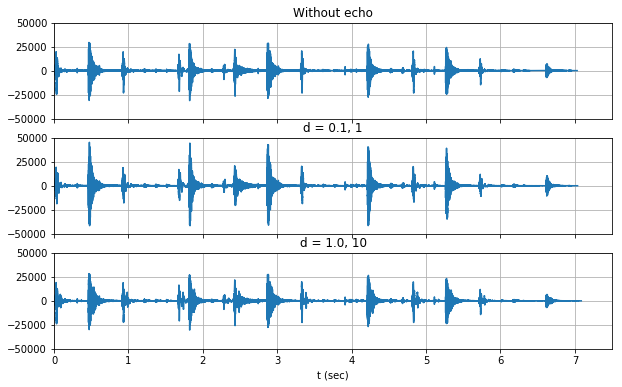

Without echo


d = 0.1, 1


d = 1.0, 10


In [5]:
fs, drums = wv.read('loop.wav')
print(fs)
d1 = [0.1, 1.] # distance vector (m)
d2 = [1., 10.]
drums_d1, filt_d1 = simple_delay(drums, d1)
drums_d2, filt_d2 = simple_delay(drums, d2)
display_waves(drums, drums_d1, drums_d2)

### b) Comb filter
In this case, the first arrival of the signal will experience loss due to traveling $d_1$ meters. The second arrival will experience path loss of $d = \sqrt{(2d_2)^2 + d_1^2}$ and one reflection. Similarly, third arrrival will have path loss of $d = \sqrt{(4d_2)^2 + d_1^2}$ and two reflections, and there will be infinite number of arrivals due to parallel walls where $n^{\text{th}}$ arrival will experience path loss due to $d = \sqrt{(2(n-1)d_2)^2 + d_1^2}$ and absorption due to $n-1$ reflections. We use an IIR filter to implement these infinite number of arrivals. 

To determine IIR filter coefficient, I approximated path length with $d \approx 2(n-1)d_2 $ so that I could achieve a recursive feedback relation where the coefficient would be $\alpha = 10^{(0.2\times2d_2) / 20}\times0.8$.

In [6]:
def comb_filter(s, d):
    p = [d[0], ((2*d[1])**2 + d[0]**2)**0.5] # travel path length (m)
    t_d = [x/v for x in p] # delays (sec)
    n_d = [int(t * (fs)) for t in t_d] # delays (# of taps)
    
    a = [10.**((2*d[0]*a_path_db) / 20.), 10.**((2*d[1]*a_path_db) / 20.)*(a_ref)] # IIR filter coeffs
    # set the first arrival to the first tap
    h_a = np.zeros(max(n_d)-n_d[0]+1)
    h_a[0] = 1.
    h_a[n_d[1] - n_d[0]] = a[1]/a[0]
    h_b = [1]
    s_e = sgn.lfilter(h_b, h_a, s)
    print('Location of arrivals (taps)', n_d)
    return s_e, h_b, h_a

In this setting when $d=[0.1, 1]$, drum beats sound deeper (wetter) but at the same time there is an artificial sound on top of the beats that makes it sound a bit robotic, due to spectral coloring of the comb filter. When $d=[1, 10]$, while it sounds it has a bit more echo compared to the no echo case, the trailing vibration-like effect, which makes it sound like there are separate beats, is still audible.

Location of arrivals (taps) [13, 280]
Location of arrivals (taps) [139, 2802]


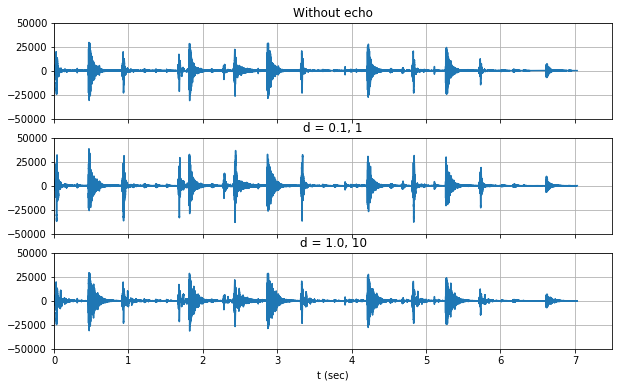

Without echo


d = 0.1, 1


d = 1.0, 10


In [7]:
drums_c1, filt_b_c1, filt_a_c1 = comb_filter(drums, d1)
drums_c2, filt_b_c2, filt_a_c2 = comb_filter(drums, d2)
display_waves(drums, drums_c1, drums_c2)

### c) All-pass filter


For the allpass filter, I used the same filter coefficient as the comb filter, but this time instead of setting $h_b$ (nominator coefficients of the filter) to 1, I set it to $[\alpha , \: 0,\dots,\: 1]$. Ideally, the last coefficient of $h_b$ and first coefficient of $h_a$ should incorporate the loss due to direct path travel, but the IIR filter implementation in Python requires $h_a[0]$ to be 1, so I ignore the direct path loss and keep them both at 1.

In [8]:
def allpass_filter(s, d):
    p = [d[0], ((2*d[1])**2 + d[0]**2)**0.5] # travel path length
    t_d = [x/v for x in p] # delays (sec)
    n_d = [int(t * (fs)) for t in t_d] # delays (# of taps)
    
    a = [10.**((2*d[0]*a_path_db) / 20.), 10.**((2*d[1]*a_path_db) / 20.)*(a_ref)] # IIR filter coeffs
    # set the first arrival to the first tap
    h_a = np.zeros(max(n_d)-n_d[0]+1)
    h_b = np.zeros(max(n_d)-n_d[0]+1)
    h_b[0] = a[1]
    h_b[n_d[1] - n_d[0]] = 1.
    h_a[0] = 1.
    h_a[n_d[1] - n_d[0]] = a[1]
    s_e = sgn.lfilter(h_b, h_a, s)
    print('Location of arrivals (taps)',n_d)
    return s_e, h_b, h_a

This time, for $d=[0.1, 1]$ case, the sound has no artificial robotic effects (coloring). It sounds more natural and has echo compared to the dry signal. For $d=[1, 10]$ case, the trailing vibrations are much more distinguishable and sound like separate beats.

Location of arrivals (taps) [13, 280]
Location of arrivals (taps) [139, 2802]


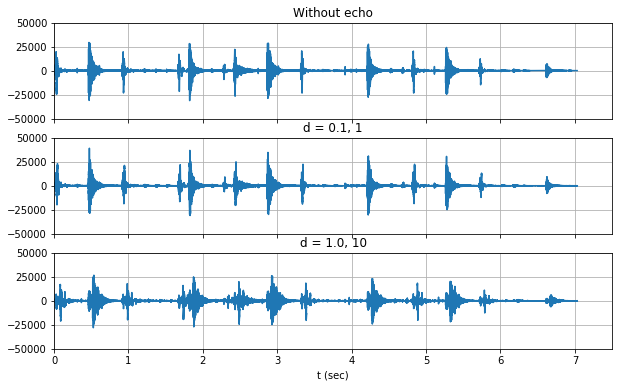

Without echo


d = 0.1, 1


d = 1.0, 10


In [9]:
drums_ap1, filt_ap1_b,  filt_ap1_a = allpass_filter(drums, d1)
drums_ap2, filt_ap2_b,  filt_ap2_a = allpass_filter(drums, d2)
display_waves(drums, drums_ap1, drums_ap2)

In [10]:
def plot_response(filt_b, filt_a):
    u = np.zeros(2000)
    u[0] = 1.
    h_c1 = sgn.lfilter(filt_b, filt_a, u)
    plt.subplot(211)
    plt.stem(h_c1)
    plt.title('Impulse response')
    plt.grid()

    w_c1, f_c1 = sgn.freqz(filt_b, filt_a, fs=fs)
    plt.subplot(212)
    plt.plot(w_c1, 20 * np.log10(abs(f_c1)), 'b')
    plt.title('Frequency response')
    plt.xlabel('Frequency [Hz]')
    plt.plot(w_c1, np.angle(f_c1), 'g')
    plt.grid()
    plt.axis('tight')
    plt.legend(['Amplitude (dB)', 'Angle (rad)'])
    plt.show()

When I compare the filter responses of comb and allpass filters, the biggest difference is allpassfilter has flat amplitude response at 0, whereas comb filter has comb-like peaks. This causes comb filter to apply different gains to different frequencies (boosting some while attenuating others) and it results in that robotic, artificial sound. Allpass filter, on the other hand, does not boost or suppress any frequency. Instead, it just changes their phase and creates the echo effect.

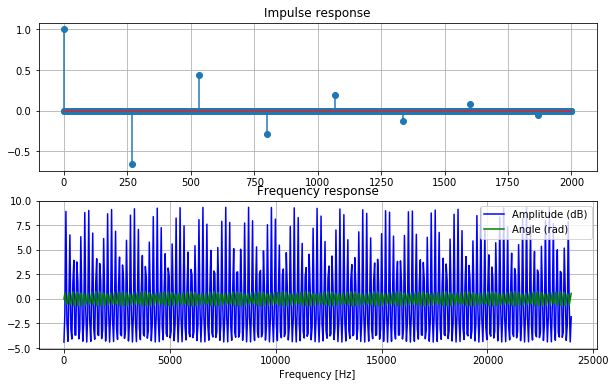

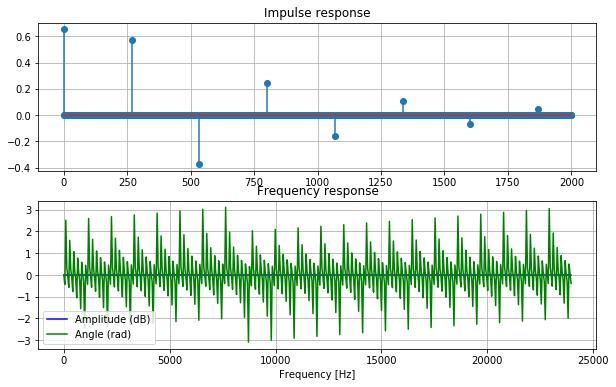

In [11]:
plot_response(filt_b_c1, filt_a_c1)
plot_response(filt_ap1_b, filt_ap1_a)

## Part 2: Schroeder reverberators

First, I tried using arbitrary distances to model each of the filters. Some of the tries sounded artificial and robotic (first example below), representing related delays, whereas some others were successful, sounding like the sound is heard in a room and coming from a distance (second example below). However, using distance as the variable, it was hard to set the delays intentionally to be related or unrelated. Hence, I modified it so that I can set the delays intentionally.

In [12]:
dc1 = [0.5, 2]
dc2 = [0.5, 1]
dc3 = [0.5, 5]
dc4 = [0.5, 4]
da1 = [0.5, 2]
da2 = [0.5, 2]
dryness = 0.6

s_c1, h_b_c1, h_a_c1 = comb_filter(drums, dc1)
s_c2, h_b_c2, h_a_c2 = comb_filter(drums, dc2)
s_c3, h_b_c3, h_a_c3 = comb_filter(drums, dc3)
s_c4, h_b_c4, h_a_c4 = comb_filter(drums, dc4)
s_c = (s_c1 + s_c2 + s_c3 + s_c4)/4.
s_ap1, h_ap1_b,  h_ap1_a = allpass_filter(s_c, da1)
s_ap2, h_ap2_b,  h_ap2_a = allpass_filter(s_ap1, da2)

s_out = s_ap2 + dryness * drums

print('Without echo')
IPython.display.display( IPython.display.Audio( drums, rate=fs))
print('Schroeder model')
IPython.display.display( IPython.display.Audio( s_out, rate=fs))


Location of arrivals (taps) [69, 564]
Location of arrivals (taps) [69, 288]
Location of arrivals (taps) [69, 1401]
Location of arrivals (taps) [69, 1121]
Location of arrivals (taps) [69, 564]
Location of arrivals (taps) [69, 564]
Without echo


Schroeder model


In [13]:
dc1 = [0.5, 2.2]
dc2 = [0.5, 1.3]
dc3 = [0.5, 3.1]
dc4 = [0.5, 1.8]
da1 = [0.2, 2.5]
da2 = [0.3, 3.8]
dryness = 0.6

s_c1, h_b_c1, h_a_c1 = comb_filter(drums, dc1)
s_c2, h_b_c2, h_a_c2 = comb_filter(drums, dc2)
s_c3, h_b_c3, h_a_c3 = comb_filter(drums, dc3)
s_c4, h_b_c4, h_a_c4 = comb_filter(drums, dc4)
s_c = (s_c1 + s_c2 + s_c3 + s_c4)/4.
s_ap1, h_ap1_b,  h_ap1_a = allpass_filter(s_c, da1)
s_ap2, h_ap2_b,  h_ap2_a = allpass_filter(s_ap1, da2)

s_out = s_ap2 + dryness * drums

print('Without echo')
IPython.display.display( IPython.display.Audio( drums, rate=fs))
print('Schroeder model')
IPython.display.display( IPython.display.Audio( s_out, rate=fs))


Location of arrivals (taps) [69, 619]
Location of arrivals (taps) [69, 370]
Location of arrivals (taps) [69, 870]
Location of arrivals (taps) [69, 508]
Location of arrivals (taps) [27, 700]
Location of arrivals (taps) [41, 1064]
Without echo


Schroeder model


Schroeder's suggested number of delay taps start from the furthest delay (e.g. $N_0=F_s/10$) and goes to the closer delays. Since the further delays will also have smaller amplitudes, I started from the closest delay instead. I converted the delays into distances by assuming the direct path to the source is at 0 distance. This should not matter since the first arrival already corresponds to the first element of the filter and its scaling is 1 for comb and allpass filters.

Compared to the previous successful arbitrary distance configuration, Schroeder reverberated clip sounds more dry. This is because since I started from the closest delays and only used 6 of them to construct filters, all the echoes are close to the first arrival and does not create a rich echo that results in a wet sound. However, it also sounds much more natural even compared to the better case above.

In [14]:
k = int(np.floor(np.log(fs/10.)/np.log(3.)))
d_filt = [0.]*k
for i in range(k):
    # start from the closest suggested delay (i = 0) and go further
    n = fs/(10.*(3.**(k - i))) # samples
    t = n / fs # sec
    x = v * t # m
    d_filt[i] = x/2.

dryness = 0.6

s_c1, h_b_c1, h_a_c1 = comb_filter(drums, [0., d_filt[0]])
s_c2, h_b_c2, h_a_c2 = comb_filter(drums, [0., d_filt[1]])
s_c3, h_b_c3, h_a_c3 = comb_filter(drums, [0., d_filt[2]])
s_c4, h_b_c4, h_a_c4 = comb_filter(drums, [0., d_filt[3]])
s_c = (s_c1 + s_c2 + s_c3 + s_c4)/4.
s_ap1, h_ap1_b,  h_ap1_a = allpass_filter(s_c,   [0., d_filt[4]])
s_ap2, h_ap2_b,  h_ap2_a = allpass_filter(s_ap1, [0., d_filt[5]])

s_out = s_ap2 + dryness * drums

print('Without echo')
IPython.display.display( IPython.display.Audio( drums, rate=fs))
print('Schroeder model')
IPython.display.display( IPython.display.Audio( s_out, rate=fs))


Location of arrivals (taps) [0, 2]
Location of arrivals (taps) [0, 6]
Location of arrivals (taps) [0, 19]
Location of arrivals (taps) [0, 59]
Location of arrivals (taps) [0, 177]
Location of arrivals (taps) [0, 533]
Without echo


Schroeder model


In order to generate more distant echoes, I used bigger delays. As expected, the resulting clip has much more echo compared to the previous case, and it sounds natural.

In [15]:
k = int(np.floor(np.log(fs/10.)/np.log(3.)))
d_filt = [0.]*k
for i in range(k):
    # start from the closest suggested delay (i = 0) and go further
    n = fs/(10.*(3.**(k - i))) # samples
    t = n / fs # sec
    x = v * t # m
    d_filt[i] = x/2.

dryness = 0.6

s_c1, h_b_c1, h_a_c1 = comb_filter(drums, [0., d_filt[-1]]) # using furthest delay
s_c2, h_b_c2, h_a_c2 = comb_filter(drums, [0., d_filt[-2]])
s_c3, h_b_c3, h_a_c3 = comb_filter(drums, [0., d_filt[-3]])
s_c4, h_b_c4, h_a_c4 = comb_filter(drums, [0., d_filt[-4]])
s_c = (s_c1 + s_c2 + s_c3 + s_c4)/4.
s_ap1, h_ap1_b,  h_ap1_a = allpass_filter(s_c,   [0., d_filt[-5]])
s_ap2, h_ap2_b,  h_ap2_a = allpass_filter(s_ap1, [0., d_filt[-6]])

s_out = s_ap2 + dryness * drums

print('Without echo')
IPython.display.display( IPython.display.Audio( drums, rate=fs))
print('Schroeder model')
IPython.display.display( IPython.display.Audio( s_out, rate=fs))


Location of arrivals (taps) [0, 1600]
Location of arrivals (taps) [0, 533]
Location of arrivals (taps) [0, 177]
Location of arrivals (taps) [0, 59]
Location of arrivals (taps) [0, 19]
Location of arrivals (taps) [0, 6]
Without echo


Schroeder model


I also tried changing dryness factor to generate a more wet signal with small delays. However, I was not able to hear a drastic change. Increasing delay times (the example above) definitely had much more perceivable effect compared to decreasing the wetness of the signal.

In [16]:
k = int(np.floor(np.log(fs/10.)/np.log(3.)))
d_filt = [0.]*k
for i in range(k):
    # start from the closest suggested delay (i = 0) and go further
    n = fs/(10.*(3.**(k - i))) # samples
    t = n / fs # sec
    x = v * t # m
    d_filt[i] = x/2.

dryness = 0.3

s_c1, h_b_c1, h_a_c1 = comb_filter(drums, [0., d_filt[0]])
s_c2, h_b_c2, h_a_c2 = comb_filter(drums, [0., d_filt[1]])
s_c3, h_b_c3, h_a_c3 = comb_filter(drums, [0., d_filt[2]])
s_c4, h_b_c4, h_a_c4 = comb_filter(drums, [0., d_filt[3]])
s_c = (s_c1 + s_c2 + s_c3 + s_c4)/4.
s_ap1, h_ap1_b,  h_ap1_a = allpass_filter(s_c,   [0., d_filt[4]])
s_ap2, h_ap2_b,  h_ap2_a = allpass_filter(s_ap1, [0., d_filt[5]])

s_out = s_ap2 + dryness * drums

print('Without echo')
IPython.display.display( IPython.display.Audio( drums, rate=fs))
print('Schroeder model')
IPython.display.display( IPython.display.Audio( s_out, rate=fs))


Location of arrivals (taps) [0, 2]
Location of arrivals (taps) [0, 6]
Location of arrivals (taps) [0, 19]
Location of arrivals (taps) [0, 59]
Location of arrivals (taps) [0, 177]
Location of arrivals (taps) [0, 533]
Without echo


Schroeder model


## Part 3: Applying a real room response

The drum roll sound in this case has much more reverberation than the ones we generated using filters in the previous parts. To see the effects of the church response on speech, I used a clip, recorded in an anechoic chamber, from McGill TSP Speech Database \[[3](http://www-mmsp.ece.mcgill.ca/Documents/Data/TSP-Speech-Database/TSP-Speech-Database.pdf)\]. The resulting speech sounded like it is recorded in a church, as expected.

In [40]:
fs_room, room = wv.read('standrews.wav')
print(fs_room, fs)

drums_church_l = sgn.convolve(drums, room[:,0])
drums_church_r = sgn.convolve(drums, room[:,1])
drums_church = np.vstack((drums_church_l, drums_church_r))
IPython.display.display( IPython.display.Audio( drums_church, rate=fs_room))

fs_speech, speech = wv.read('FC13_06.wav')
print(fs_room, fs)
speech_church_l = sgn.convolve(speech, room[:,0])
speech_church_r = sgn.convolve(speech, room[:,1])
speech_church = np.vstack((speech_church_l, speech_church_r))
print('Original speech')
IPython.display.display( IPython.display.Audio( speech, rate=fs_speech))
print('Speech in church')
IPython.display.display( IPython.display.Audio( speech_church, rate=fs_speech))


48000 48000


48000 48000
Original speech


Speech in church
